<a href="https://colab.research.google.com/github/awantika362/Big-Mart-Sales-Prediction/blob/master/online_retail_transactions_EDA.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# About Dataset

The "Online Retail Transaction" dataset contains information on transactions made by customers through an online retail platform. The dataset includes data on the products that were purchased, the quantity of each product, the date and time of each transaction, the price of each product, the unique identifier for each customer who made a purchase, and the country where each customer is located. This dataset can be used to analyze customer behavior and preferences, identify popular products, and optimize pricing and marketing strategies. The dataset is well-suited for data analysis and machine learning applications, as it contains a large volume of transactional data that can be used to train predictive models and make data-driven decisions.

# Column Descriptors

1. StockCode: A code used to identify the product that was purchased

2. Description: A brief description of the product that was purchased

3. Quantity: The quantity of the product that was purchased

4. InvoiceDate: The date and time that the purchase was made

5. UnitPrice: The price of one unit of the product that was purchased

6. CustomerID: The unique identifier for the customer who made the purchase

7. Country: The country where the customer who made the purchase is located

# Importing Important libraries

In [102]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
import warnings
import datetime
from wordcloud import WordCloud
warnings.filterwarnings('ignore' )
import plotly.express as px
sns.set_style('darkgrid')
plt.rcParams['figure.figsize']=(15,8)
plt.rcParams['font.size']=18

# Reading Data Csv File

In [103]:
df_1 = pd.read_csv("Online Retail.csv")

In [104]:
# top 5 rows
df_1.head()

,InvoiceNo,StockCode,Description,Quantity,InvoiceDate,UnitPrice,CustomerID,Country
0,536365,85123A,WHITE HANGING HEART T-LIGHT HOLDER,6,2010-12-01 08:26:00,2.55,17850,United Kingdom
1,536365,71053,WHITE METAL LANTERN,6,2010-12-01 08:26:00,3.39,17850,United Kingdom
2,536365,84406B,CREAM CUPID HEARTS COAT HANGER,8,2010-12-01 08:26:00,2.75,17850,United Kingdom
3,536365,84029G,KNITTED UNION FLAG HOT WATER BOTTLE,6,2010-12-01 08:26:00,3.39,17850,United Kingdom
4,536365,84029E,RED WOOLLY HOTTIE WHITE HEART.,6,2010-12-01 08:26:00,3.39,17850,United Kingdom


In [105]:
# last 5 rows
df_1.tail()

,InvoiceNo,StockCode,Description,Quantity,InvoiceDate,UnitPrice,CustomerID,Country
541904,581587,22613,PACK OF 20 SPACEBOY NAPKINS,12,2011-12-09 12:50:00,0.85,12680,France
541905,581587,22899,CHILDREN'S APRON DOLLY GIRL,6,2011-12-09 12:50:00,2.10,12680,France
541906,581587,23254,CHILDRENS CUTLERY DOLLY GIRL,4,2011-12-09 12:50:00,4.15,12680,France
541907,581587,23255,CHILDRENS CUTLERY CIRCUS PARADE,4,2011-12-09 12:50:00,4.15,12680,France
541908,581587,22138,BAKING SET 9 PIECE RETROSPOT,3,2011-12-09 12:50:00,4.95,12680,France


In [106]:
# total no of columns and rows
print(f"Total No of Rows = {df_1.shape[0]} and Columns = {df_1.shape[1]}")


Total No of Rows = 541909 and Columns = 8


* Total 58495 rows and 8 columns are there

*   List item

1.   List item
2.   List item


*   List item



In [107]:
df_1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 541909 entries, 0 to 541908
Data columns (total 8 columns):
 #   Column       Non-Null Count   Dtype  
---  ------       --------------   -----  
 0   InvoiceNo    541909 non-null  object 
 1   StockCode    541909 non-null  object 
 2   Description  540455 non-null  object 
 3   Quantity     541909 non-null  int64  
 4   InvoiceDate  541909 non-null  object 
 5   UnitPrice    541909 non-null  float64
 6   CustomerID   541909 non-null  int64  
 7   Country      541909 non-null  object 
dtypes: float64(1), int64(2), object(5)
memory usage: 33.1+ MB


In [108]:
# checking duplicated values
df_1.duplicated().sum()

5268

In [109]:
print(f"{df_1.duplicated().mean()*100}%")

0.9721189350979592%


* There is duplicated values is present which around 0.97% 


In [110]:
# droping Duplicated values
df_1.drop_duplicates(inplace = True)

In [111]:
cat_cols = df_1.select_dtypes(include=["object"]).columns
num_cols = df_1.select_dtypes(include=['int','float']).columns

# 3) Data Cleaning

# 3.1) Handling missing values and other anomolies

* Checking for Missing values in DataFrame using is null function

In [112]:
df_1.isnull().sum()

InvoiceNo         0
StockCode         0
Description    1454
Quantity          0
InvoiceDate       0
UnitPrice         0
CustomerID        0
Country           0
dtype: int64

In [113]:
df_1.isnull().mean()

InvoiceNo      0.000000
StockCode      0.000000
Description    0.002709
Quantity       0.000000
InvoiceDate    0.000000
UnitPrice      0.000000
CustomerID     0.000000
Country        0.000000
dtype: float64

In [114]:
df_1.isnull().mean().sort_values(ascending=False)

Description    0.002709
InvoiceNo      0.000000
StockCode      0.000000
Quantity       0.000000
InvoiceDate    0.000000
UnitPrice      0.000000
CustomerID     0.000000
Country        0.000000
dtype: float64

In [115]:
(df_1.isnull().mean().sort_values(ascending=False)[0:3])*100

Description    0.270945
InvoiceNo      0.000000
StockCode      0.000000
dtype: float64

In [116]:
def plot_nas(df: pd.DataFrame):
    if df.isnull().sum().sum() != 0:
        na_df = (df.isnull().sum() / len(df)) * 100      
        na_df = na_df.drop(na_df[na_df == 0].index).sort_values(ascending=False)
        missing_data = pd.DataFrame({'Missing Ratio %' :na_df})
        missing_data.plot(kind = "bar")
        plt.figure(figsize=(10,6))
        plt.show()
        
    else:
        print('No NAs found')

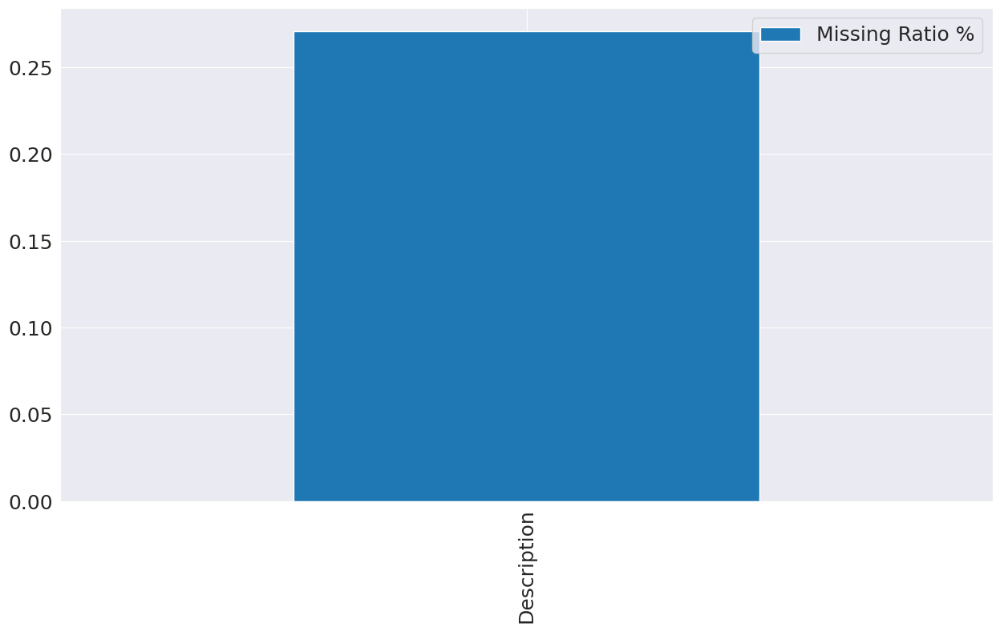

<Figure size 1000x600 with 0 Axes>

In [117]:
plot_nas(df_1)

1. As we have almost 0.27% Null Values in "Description" Columns
2. we can drop null values

In [118]:
df_1.dropna(inplace = True)

In [119]:
variables = []
dtypes = []
count = []
unique = []
missing = []


for item in df_1.columns:
    variables.append(item)
    dtypes.append(df_1[item].dtype)
    count.append(len(df_1[item]))
    unique.append(len(df_1[item].unique()))
    missing.append(df_1[item].isna().sum())

output = pd.DataFrame({
    'variable': variables, 
    'dtype': dtypes,
    'count': count,
    'unique': unique,
    'missing': missing, 
   
})    

output.sort_values("missing",ascending=False).reset_index(drop=True)
output

,variable,dtype,count,unique,missing
0,InvoiceNo,object,535187,24446,0
1,StockCode,object,535187,3958,0
2,Description,object,535187,4223,0
3,Quantity,int64,535187,671,0
4,InvoiceDate,object,535187,22309,0
5,UnitPrice,float64,535187,1630,0
6,CustomerID,int64,535187,4372,0
7,Country,object,535187,38,0


## 3.2) Checking Unique values

* count unique values in each columns

In [120]:
df_1.nunique()

InvoiceNo      24446
StockCode       3958
Description     4223
Quantity         671
InvoiceDate    22309
UnitPrice       1630
CustomerID      4372
Country           38
dtype: int64

# 3.3) Apply Prepocessing Technique to clean Unit Price Column

In [121]:
# this data frame contain non negative values and greater than 0
df_1 = df_1[df_1['UnitPrice'] > 0]
df_1.head()

,InvoiceNo,StockCode,Description,Quantity,InvoiceDate,UnitPrice,CustomerID,Country
0,536365,85123A,WHITE HANGING HEART T-LIGHT HOLDER,6,2010-12-01 08:26:00,2.55,17850,United Kingdom
1,536365,71053,WHITE METAL LANTERN,6,2010-12-01 08:26:00,3.39,17850,United Kingdom
2,536365,84406B,CREAM CUPID HEARTS COAT HANGER,8,2010-12-01 08:26:00,2.75,17850,United Kingdom
3,536365,84029G,KNITTED UNION FLAG HOT WATER BOTTLE,6,2010-12-01 08:26:00,3.39,17850,United Kingdom
4,536365,84029E,RED WOOLLY HOTTIE WHITE HEART.,6,2010-12-01 08:26:00,3.39,17850,United Kingdom


In [122]:
df_1[df_1['UnitPrice']==0]

,InvoiceNo,StockCode,Description,Quantity,InvoiceDate,UnitPrice,CustomerID,Country


# 3.4) Applying PreProcessing Technique on Quantity Columns

In [123]:
df_1[df_1['Quantity']<0]

,InvoiceNo,StockCode,Description,Quantity,InvoiceDate,UnitPrice,CustomerID,Country
141,C536379,D,Discount,-1,2010-12-01 09:41:00,27.50,14527,United Kingdom
154,C536383,35004C,SET OF 3 COLOURED FLYING DUCKS,-1,2010-12-01 09:49:00,4.65,15311,United Kingdom
235,C536391,22556,PLASTERS IN TIN CIRCUS PARADE,-12,2010-12-01 10:24:00,1.65,17548,United Kingdom
236,C536391,21984,PACK OF 12 PINK PAISLEY TISSUES,-24,2010-12-01 10:24:00,0.29,17548,United Kingdom
237,C536391,21983,PACK OF 12 BLUE PAISLEY TISSUES,-24,2010-12-01 10:24:00,0.29,17548,United Kingdom
...,...,...,...,...,...,...,...,...
540449,C581490,23144,ZINC T-LIGHT HOLDER STARS SMALL,-11,2011-12-09 09:57:00,0.83,14397,United Kingdom
541541,C581499,M,Manual,-1,2011-12-09 10:28:00,224.69,15498,United Kingdom
541715,C581568,21258,VICTORIAN SEWING BOX LARGE,-5,2011-12-09 11:57:00,10.95,15311,United Kingdom
541716,C581569,84978,HANGING HEART JAR T-LIGHT HOLDER,-1,2011-12-09 11:58:00,1.25,17315,United Kingdom


In [124]:
df_1["Quantity"] = df_1['Quantity'].abs()

In [125]:
df_1[df_1['Quantity']<0]

,InvoiceNo,StockCode,Description,Quantity,InvoiceDate,UnitPrice,CustomerID,Country


* There is no Negative values present in Quantity column

# 3.5) Applying PreProcessing Technique on InvoiceDate Columns

In [126]:
df_1['Year'] = pd.to_datetime(df_1["InvoiceDate"]).dt.year
df_1['Month'] = pd.to_datetime(df_1["InvoiceDate"]).dt.month_name()
df_1['Week'] = pd.to_datetime(df_1["InvoiceDate"]).dt.week
df_1['day'] = pd.to_datetime(df_1["InvoiceDate"]).dt.day
df_1['Weekday'] = pd.to_datetime(df_1["InvoiceDate"]).dt.weekday
df_1["Day_Name"] = pd.to_datetime(df_1["InvoiceDate"]).dt.day_name()


In [127]:
# Create new column with time interval labels
df_1['Time'] = pd.to_datetime(df_1['InvoiceDate']).dt.hour
df_1['Time of Day'] = ['Early Morning' if x < 6 
                     else ('Morning' if x < 12 
                           else ('Noon' if x < 14 
                                 else ('Afternoon' if x < 18 
                                       else ('Evening' if x < 22 else 'Night')))) for x in df_1['Time']]

# 3.6) Create a Sales Columns

In [128]:
# Create column of sales 
# Sales = qty * price
df_1['Sales'] = df_1['Quantity'] * df_1['UnitPrice']
df_1['Sales'].head()

0    15.30
1    20.34
2    22.00
3    20.34
4    20.34
Name: Sales, dtype: float64

In [129]:
df_1

,InvoiceNo,StockCode,Description,Quantity,InvoiceDate,UnitPrice,CustomerID,Country,Year,Month,Week,day,Weekday,Day_Name,Time,Time of Day,Sales
0,536365,85123A,WHITE HANGING HEART T-LIGHT HOLDER,6,2010-12-01 08:26:00,2.55,17850,United Kingdom,2010,December,48,1,2,Wednesday,8,Morning,15.30
1,536365,71053,WHITE METAL LANTERN,6,2010-12-01 08:26:00,3.39,17850,United Kingdom,2010,December,48,1,2,Wednesday,8,Morning,20.34
2,536365,84406B,CREAM CUPID HEARTS COAT HANGER,8,2010-12-01 08:26:00,2.75,17850,United Kingdom,2010,December,48,1,2,Wednesday,8,Morning,22.00
3,536365,84029G,KNITTED UNION FLAG HOT WATER BOTTLE,6,2010-12-01 08:26:00,3.39,17850,United Kingdom,2010,December,48,1,2,Wednesday,8,Morning,20.34
4,536365,84029E,RED WOOLLY HOTTIE WHITE HEART.,6,2010-12-01 08:26:00,3.39,17850,United Kingdom,2010,December,48,1,2,Wednesday,8,Morning,20.34
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
541904,581587,22613,PACK OF 20 SPACEBOY NAPKINS,12,2011-12-09 12:50:00,0.85,12680,France,2011,December,49,9,4,Friday,12,Noon,10.20
541905,581587,22899,CHILDREN'S APRON DOLLY GIRL,6,2011-12-09 12:50:00,2.10,12680,France,2011,December,49,9,4,Friday,12,Noon,12.60
541906,581587,23254,CHILDRENS CUTLERY DOLLY GIRL,4,2011-12-09 12:50:00,4.15,12680,France,2011,December,49,9,4,Friday,12,Noon,16.60
541907,581587,23255,CHILDRENS CUTLERY CIRCUS PARADE,4,2011-12-09 12:50:00,4.15,12680,France,2011,December,49,9,4,Friday,12,Noon,16.60


In [130]:
df_1.describe()

,Quantity,UnitPrice,CustomerID,Year,Week,day,Weekday,Time,Sales
count,534129.000000,534129.000000,534129.000000,534129.000000,534129.000000,534129.000000,534129.000000,534129.000000,534129.000000
mean,10.948629,4.695864,15282.689715,2010.921910,30.705013,15.020371,2.425337,13.075341,21.597948
std,216.402375,95.079189,1486.141831,0.268313,15.144652,8.659914,1.841672,2.447742,380.770267
min,1.000000,0.001000,12346.000000,2010.000000,1.000000,1.000000,0.000000,6.000000,0.001000
25%,1.000000,1.250000,14344.000000,2011.000000,18.000000,7.000000,1.000000,11.000000,3.900000
50%,3.000000,2.100000,15287.000000,2011.000000,34.000000,15.000000,2.000000,13.000000,9.920000
75%,11.000000,4.130000,16248.000000,2011.000000,45.000000,22.000000,4.000000,15.000000,17.700000
max,80995.000000,38970.000000,18287.000000,2011.000000,51.000000,31.000000,6.000000,20.000000,168469.600000


In [131]:
df_1.describe(include = "object").T

,count,unique,top,freq
InvoiceNo,534129,23796,573585,1114
StockCode,534129,3938,85123A,2295
Description,534129,4042,WHITE HANGING HEART T-LIGHT HOLDER,2353
InvoiceDate,534129,21802,2011-10-31 14:41:00,1114
Country,534129,38,United Kingdom,487806
Month,534129,12,November,83077
Day_Name,534129,6,Thursday,102561
Time of Day,534129,4,Afternoon,224665


# Explaratory Data Analysis (EDA)

# CustomerID with the highest Quantity

In [132]:
# sort the dataframe by Quantity in descending order
sorted_df = df_1.sort_values(by=['Quantity'], ascending=False)

# get the CustomerID with the highest Quantity
customer_id = sorted_df.iloc[0]['CustomerID']
highest_quantity = sorted_df.iloc[0]['Quantity']

print(f"CustomerID {customer_id}  bought the highest quantity of {highest_quantity}.")

CustomerID 16446  bought the highest quantity of 80995.


# Top 10 Customers by Quantity

In [133]:
customer_totals = df_1.groupby('CustomerID')['Quantity'].sum()

# sort the customer_totals by Quantity in descending order
sorted_totals = customer_totals.sort_values(ascending=False)

# get the top 10 customer IDs
top_10_customers = sorted_totals.head(10)

print("Top 10 Customers by Quantity:")
print(top_10_customers)

Top 10 Customers by Quantity:
CustomerID
15287    423377
14646    197687
16446    161992
12346    148430
14911     83575
12415     77802
17450     70937
17511     66086
13694     64725
18102     64126
Name: Quantity, dtype: int64


# Ploting between Top 10 Customers by Quantity

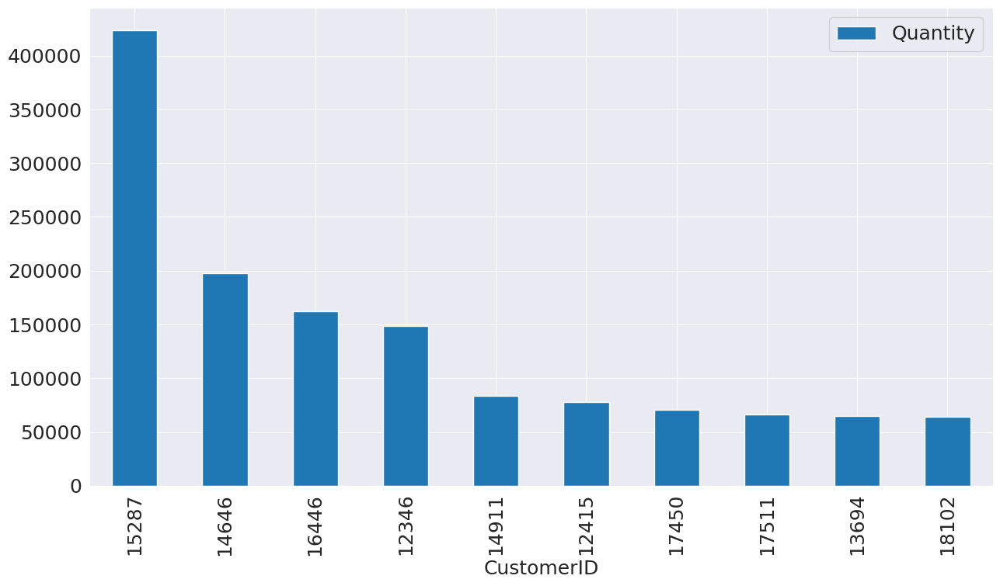

In [134]:
sorted_totals.head(10).plot(kind="bar")
plt.legend()
plt.show()

# Time of Day Barchart

In [135]:
fig = px.bar(data_frame = df_1.groupby(by=["Time of Day"]).size().reset_index(name="counts"),
            x="Time of Day", y="counts")
fig.show()

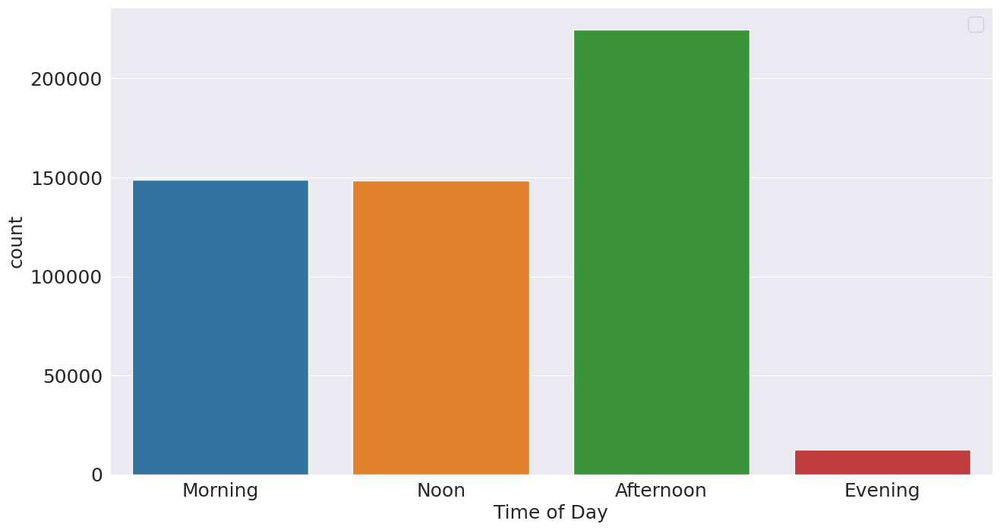

In [136]:
sns.countplot(data= df_1, x= "Time of Day")
plt.legend()
plt.show()

# Time of Day pieChart

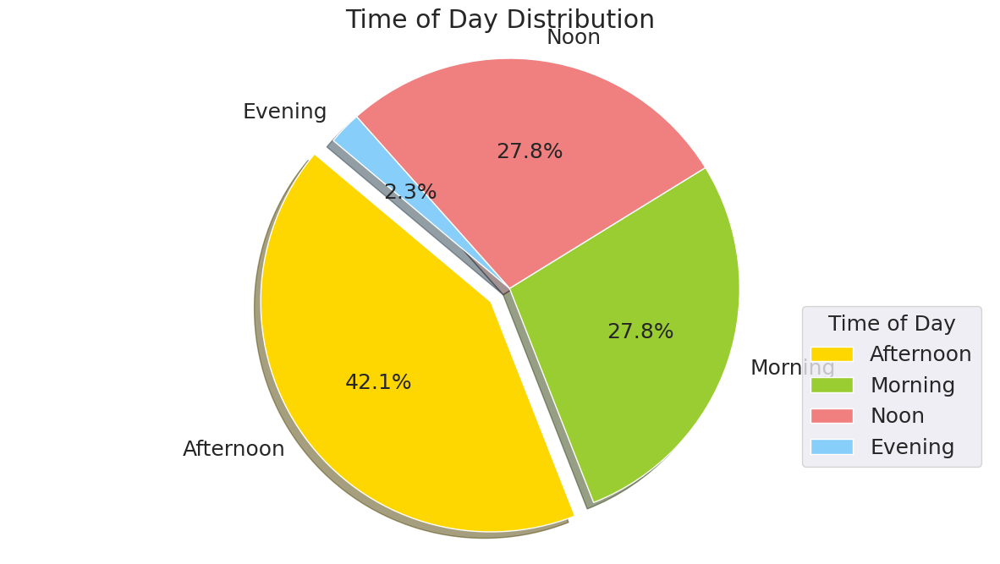

In [137]:
counts = df_1['Time of Day'].value_counts()

# Data
labels = counts.index.tolist()
sizes = counts.tolist()
colors = ['gold', 'yellowgreen', 'lightcoral', 'lightskyblue']
explode = (0.1, 0, 0, 0)  # explode 1st slice

# Plot
plt.pie(sizes, explode=explode, labels=labels, colors=colors,
        autopct='%1.1f%%', shadow=True, startangle=140)
plt.title('Time of Day Distribution')

plt.axis('equal')
plt.legend(title='Time of Day', loc='best', bbox_to_anchor=(1, 0.5))
plt.show()

# Time of Day Distribution Vs Sales

In [140]:
fig = px.bar(data_frame = df_1,
             x = 'Time of Day',
             y ="Sales")
fig.show()

In [141]:
fig = px.line(data_frame = df_1,
             x = 'Time of Day',
             y ="Sales")
fig.show()

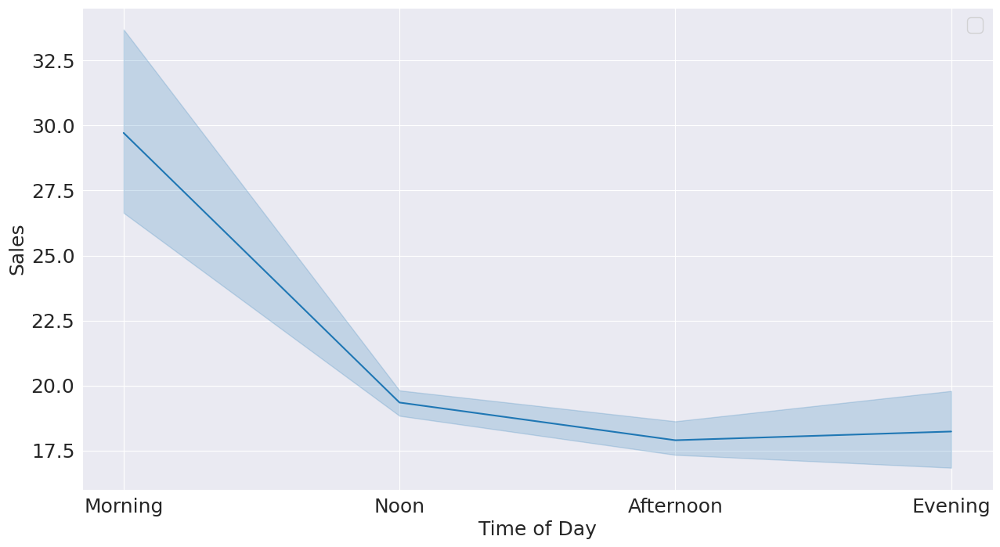

In [142]:
sns.lineplot(data= df_1,x="Time of Day", y ='Sales')
plt.legend()
plt.show()

* During Morning time sales is maximum 
* In Afternoon sales is minimun

# Sales Distribution
1. Which country have the most transaction sales?
2. Which year that have the most sales?
3. Which month that have the most sales?
4. Which day that have the most sales?
5. Top 10 item that have the most sales.
6. Sales Vs Time


Which country have the most transaction sales?


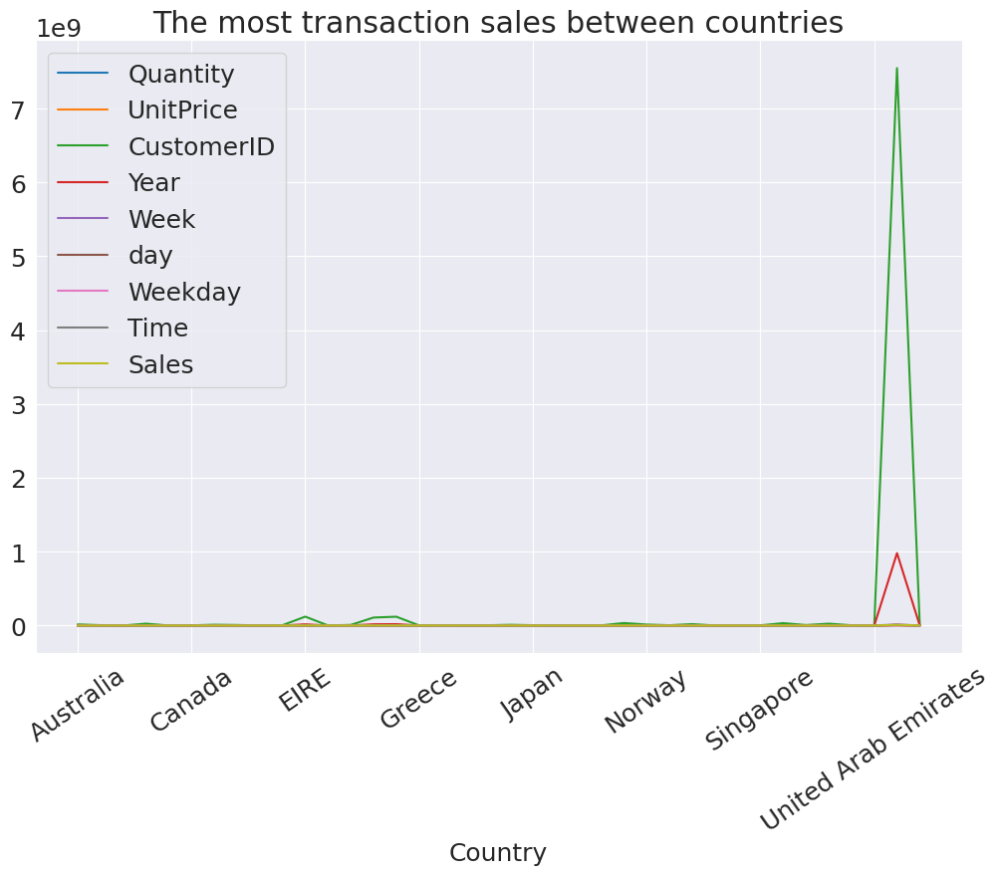

In [143]:
df_country = df_1.groupby(by=['Country']).sum()
df_country.plot(kind='line', figsize=(12,8))
plt.title("The most transaction sales between countries")
plt.xticks(rotation=35)
plt.show()

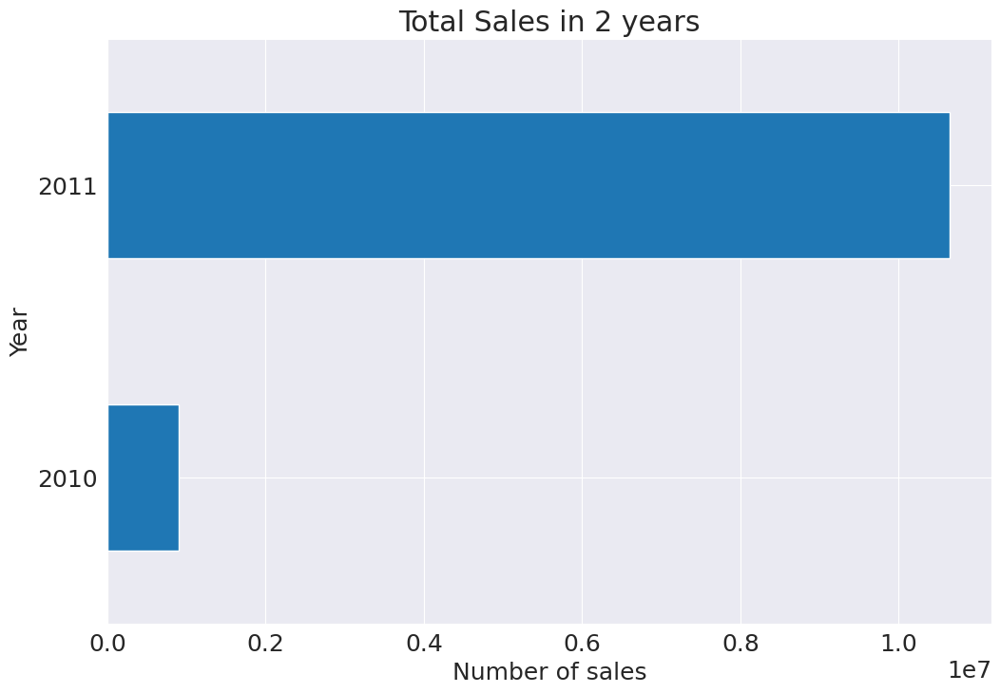

In [146]:
df_year = df_1.groupby(by=['Year']).sum()['Sales']\
.plot(kind='barh',figsize=(12,8))
plt.title('Total Sales in 2 years')
plt.xlabel('Number of sales')
plt.ylabel('Year')
plt.show()

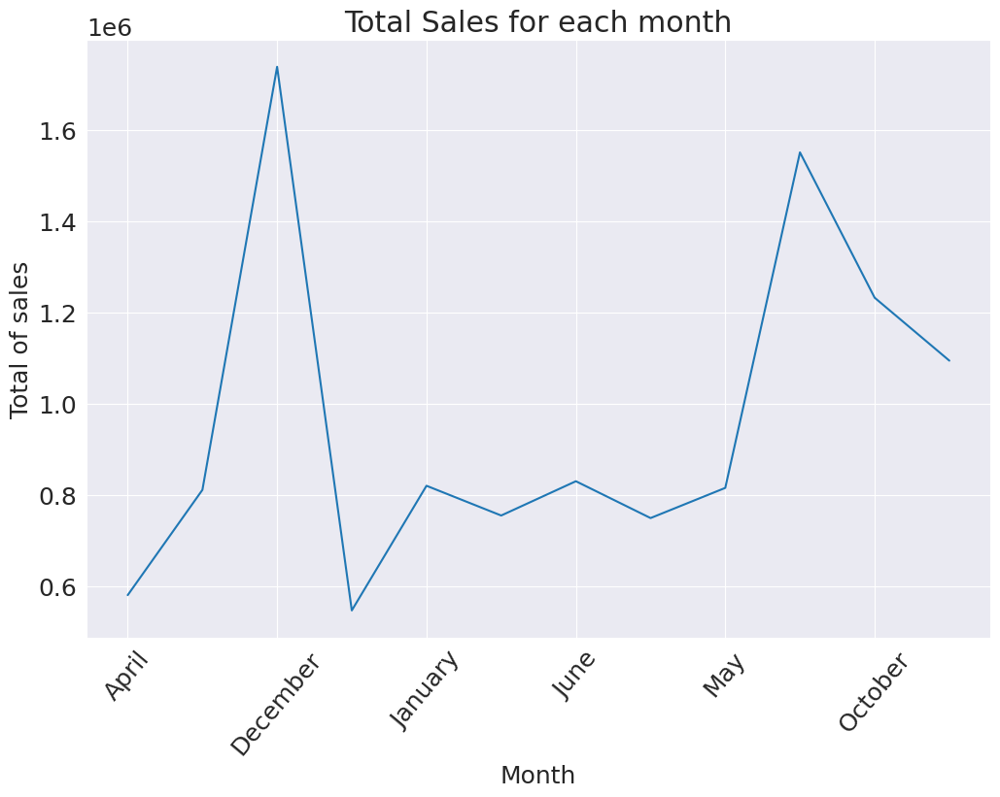

In [151]:
df_month = df_1.groupby(by=['Month']).sum()['Sales']\
.plot(kind='line',figsize=(12,8))
plt.title('Total Sales for each month')
plt.ylabel('Total of sales')
plt.xlabel('Month')
plt.xticks(rotation=50)
plt.show()

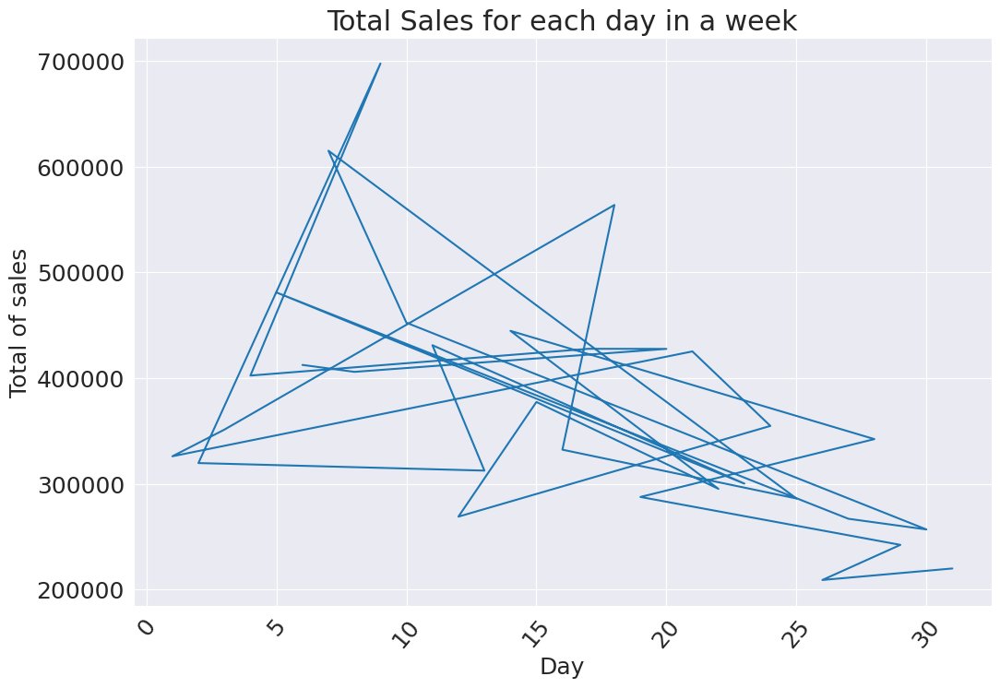

In [154]:
df_dayofweek = df_1.groupby(by=['day']).sum().sort_values('Weekday',ascending=True)['Sales']\
.plot(kind='line',figsize=(12,8))
plt.title('Total Sales for each day in a week')
plt.ylabel('Total of sales')
plt.xlabel('Day')
plt.xticks(rotation=50)
plt.show()

In [153]:
df_1

,InvoiceNo,StockCode,Description,Quantity,InvoiceDate,UnitPrice,CustomerID,Country,Year,Month,Week,day,Weekday,Day_Name,Time,Time of Day,Sales
0,536365,85123A,WHITE HANGING HEART T-LIGHT HOLDER,6,2010-12-01 08:26:00,2.55,17850,United Kingdom,2010,December,48,1,2,Wednesday,8,Morning,15.30
1,536365,71053,WHITE METAL LANTERN,6,2010-12-01 08:26:00,3.39,17850,United Kingdom,2010,December,48,1,2,Wednesday,8,Morning,20.34
2,536365,84406B,CREAM CUPID HEARTS COAT HANGER,8,2010-12-01 08:26:00,2.75,17850,United Kingdom,2010,December,48,1,2,Wednesday,8,Morning,22.00
3,536365,84029G,KNITTED UNION FLAG HOT WATER BOTTLE,6,2010-12-01 08:26:00,3.39,17850,United Kingdom,2010,December,48,1,2,Wednesday,8,Morning,20.34
4,536365,84029E,RED WOOLLY HOTTIE WHITE HEART.,6,2010-12-01 08:26:00,3.39,17850,United Kingdom,2010,December,48,1,2,Wednesday,8,Morning,20.34
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
541904,581587,22613,PACK OF 20 SPACEBOY NAPKINS,12,2011-12-09 12:50:00,0.85,12680,France,2011,December,49,9,4,Friday,12,Noon,10.20
541905,581587,22899,CHILDREN'S APRON DOLLY GIRL,6,2011-12-09 12:50:00,2.10,12680,France,2011,December,49,9,4,Friday,12,Noon,12.60
541906,581587,23254,CHILDRENS CUTLERY DOLLY GIRL,4,2011-12-09 12:50:00,4.15,12680,France,2011,December,49,9,4,Friday,12,Noon,16.60
541907,581587,23255,CHILDRENS CUTLERY CIRCUS PARADE,4,2011-12-09 12:50:00,4.15,12680,France,2011,December,49,9,4,Friday,12,Noon,16.60


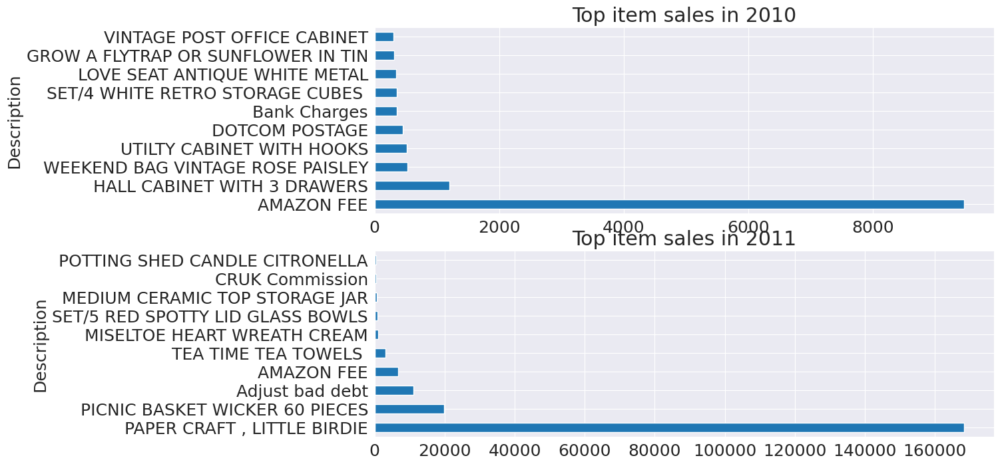

In [155]:
plt.subplot(2,1,1)
# creating the bar plot
df_sales_item_2010 = df_1.groupby(['Description','Year']).mean()
df_sales_item_2010 = df_sales_item_2010.unstack('Year')['Sales']
df_sales_item_2010 = df_sales_item_2010.sort_values(2010,ascending=False)[2010].head(10).plot(kind='barh',figsize=(12,8))
plt.title("Top item sales in 2010")
plt.subplot(2,1,2)
df_sales_item_2011 = df_1.groupby(['Description','Year']).mean()
df_sales_item_2011 = df_sales_item_2011.unstack('Year')['Sales']
df_sales_item_2011 = df_sales_item_2011.sort_values(2011,ascending=False)[2011].head(10).plot(kind='barh',figsize=(12,8))

plt.title("Top item sales in 2011")
plt.show()

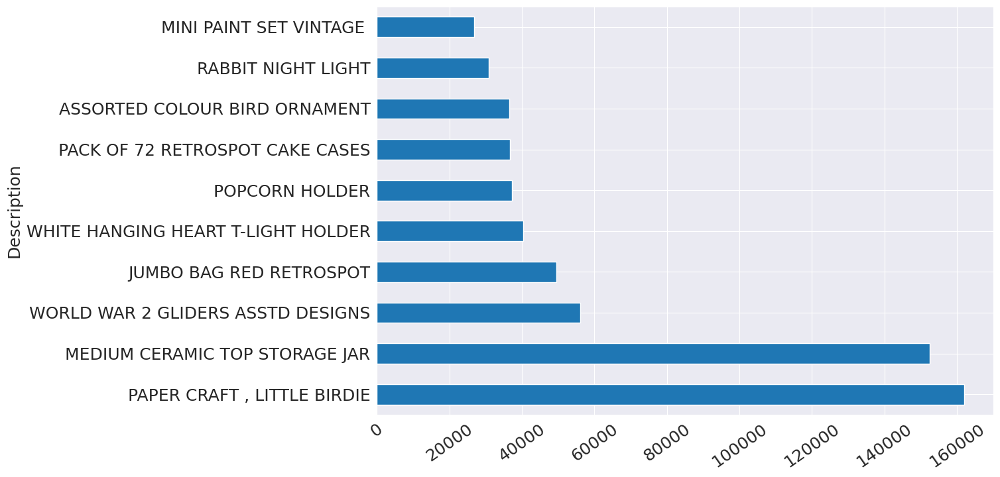

In [156]:
df_purchased_item = df_1.groupby('Description').sum()
df_purchased_item = df_purchased_item.sort_values('Quantity',ascending=False).head(10)
df_purchased_item['Quantity'].plot(kind = 'barh',figsize=(12,8))
plt.xticks(rotation=35)
plt.show()

In [157]:
df_1

,InvoiceNo,StockCode,Description,Quantity,InvoiceDate,UnitPrice,CustomerID,Country,Year,Month,Week,day,Weekday,Day_Name,Time,Time of Day,Sales
0,536365,85123A,WHITE HANGING HEART T-LIGHT HOLDER,6,2010-12-01 08:26:00,2.55,17850,United Kingdom,2010,December,48,1,2,Wednesday,8,Morning,15.30
1,536365,71053,WHITE METAL LANTERN,6,2010-12-01 08:26:00,3.39,17850,United Kingdom,2010,December,48,1,2,Wednesday,8,Morning,20.34
2,536365,84406B,CREAM CUPID HEARTS COAT HANGER,8,2010-12-01 08:26:00,2.75,17850,United Kingdom,2010,December,48,1,2,Wednesday,8,Morning,22.00
3,536365,84029G,KNITTED UNION FLAG HOT WATER BOTTLE,6,2010-12-01 08:26:00,3.39,17850,United Kingdom,2010,December,48,1,2,Wednesday,8,Morning,20.34
4,536365,84029E,RED WOOLLY HOTTIE WHITE HEART.,6,2010-12-01 08:26:00,3.39,17850,United Kingdom,2010,December,48,1,2,Wednesday,8,Morning,20.34
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
541904,581587,22613,PACK OF 20 SPACEBOY NAPKINS,12,2011-12-09 12:50:00,0.85,12680,France,2011,December,49,9,4,Friday,12,Noon,10.20
541905,581587,22899,CHILDREN'S APRON DOLLY GIRL,6,2011-12-09 12:50:00,2.10,12680,France,2011,December,49,9,4,Friday,12,Noon,12.60
541906,581587,23254,CHILDRENS CUTLERY DOLLY GIRL,4,2011-12-09 12:50:00,4.15,12680,France,2011,December,49,9,4,Friday,12,Noon,16.60
541907,581587,23255,CHILDRENS CUTLERY CIRCUS PARADE,4,2011-12-09 12:50:00,4.15,12680,France,2011,December,49,9,4,Friday,12,Noon,16.60


How much average sales for all transaction(each invoice)


In [158]:
df_invoice = df_1.groupby(by=['InvoiceNo']).sum()[['Sales','Quantity']]
px.box(df_invoice)